<a href="https://colab.research.google.com/github/cauqqzhang/plot_fire_using_image-service/blob/main/new_wmts.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from IPython.display import HTML

HTML('''<script>
code_show=true;
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
}
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import geopandas as gpd

In [ ]:
geojson="Board_of_Supervisor_Districts_-_Effective_Jan._7th_2022.geojson"

In [ ]:
cal=gpd.read_file(geojson)

In [ ]:
aoi=gpd.read_file("bou.shp")

In [ ]:
from shapely.geometry import Point

In [ ]:
from matplotlib import pyplot as plt

In [ ]:
amsterdamish = Point((-119.538330,37.865101))
gdf_am = gpd.GeoSeries([amsterdamish], crs={'init': 'epsg:4326'})

# Location from SNS

Text(-119.53833, 37.865101, 'Washburn Fire')

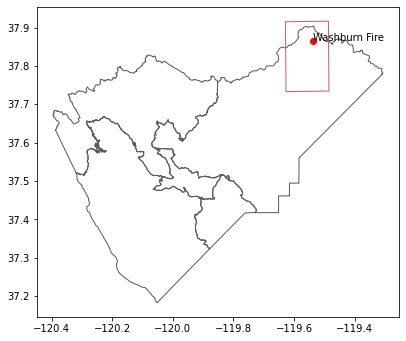

In [ ]:
fig, ax = plt.subplots(figsize=(6.5, 6.5))
cal.plot(ax=ax, facecolor='None', edgecolor='0.35')
aoi.plot(ax=ax, facecolor='None', edgecolor='Indianred')
gdf_am.plot(ax=ax,color='red')
plt.text(-119.538330,37.865101, 'Washburn Fire')

In [ ]:
from IPython.display import Image, Video

# Washburn Fire IR Map for July , 2022 from  Gov

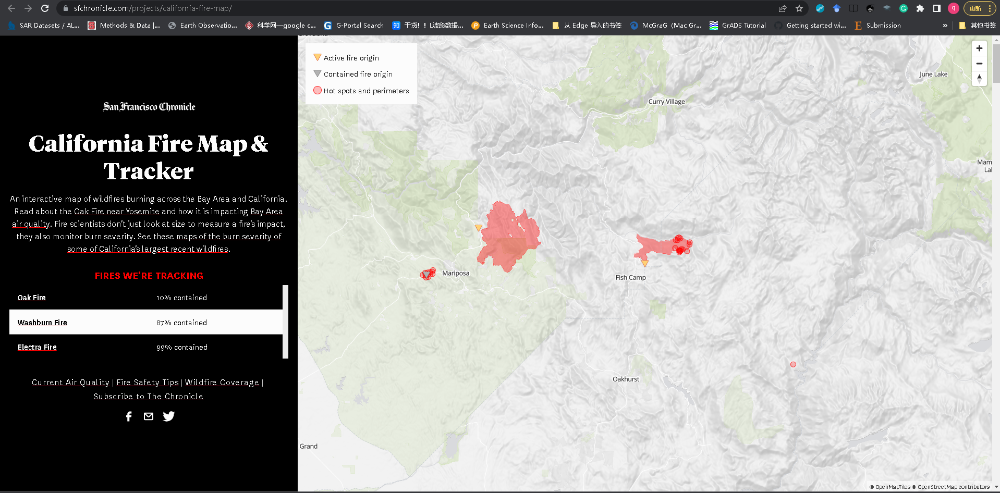

In [ ]:
Image("2022-07-26_105433.png")

# Fire Tracker

In [ ]:
%%HTML
<video width="800" height="500" controls>
  <source src="Video_2022-07-26_110150.mp4" type="video/mp4">
</video>

# Map1

In [ ]:
Image("http://inciweb.nwcg.gov/photos/CAYNP/2022-07-08-0903-Washburn/picts/2022_07_24-08.33.37.485-CDT.jpeg")

# Map2

In [ ]:
Image("https://inciweb.nwcg.gov/photos/CAYNP/2022-07-08-0903-Washburn/picts/2022_07_25-09.44.17.852-CDT.jpeg" )

# Map3

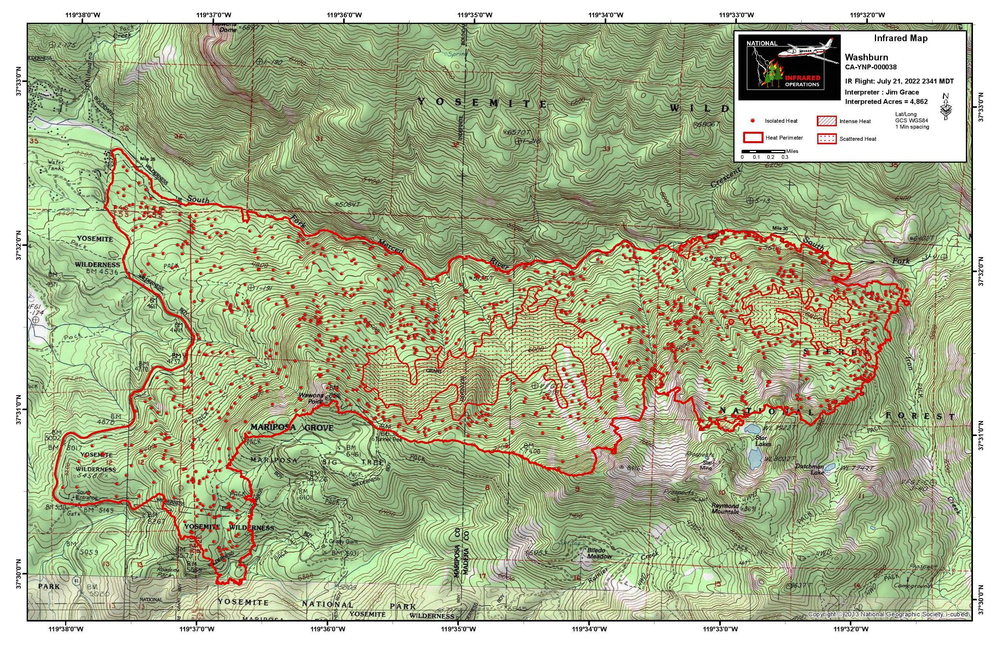

In [ ]:
Image("http://inciweb.nwcg.gov/photos/CAYNP/2022-07-08-0903-Washburn/picts/2022_07_22-08.12.27.530-CDT.jpeg")

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patheffects as PathEffects
import cartopy.crs as ccrs
from owslib.wmts import WebMapTileService

In [ ]:
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature

In [ ]:
shape_feature = ShapelyFeature(aoi.geometry, ccrs.Geodetic(),
                linewidth = 2, facecolor = (1, 1, 1, 0),
                edgecolor = 'red')

In [ ]:
import numpy as np

# Terra: 07-22 -Band-143(L):367(R) local

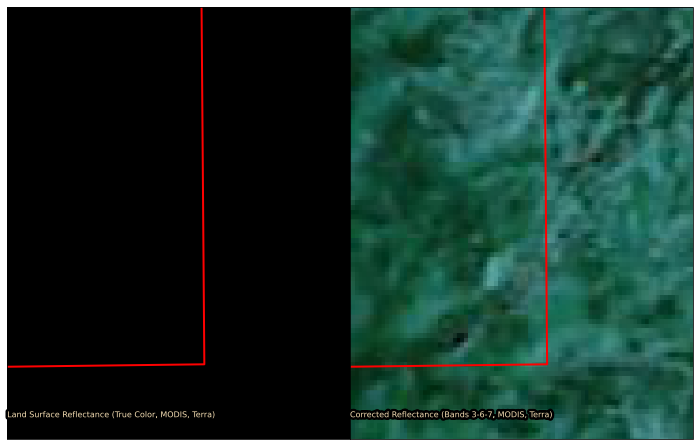

In [ ]:
def main():
    # URL of NASA GIBS
    URL = 'http://gibs.earthdata.nasa.gov/wmts/epsg4326/best/wmts.cgi'
    wmts = WebMapTileService(URL)

    # Layers for MODIS true color and snow RGB
    layers = ['MODIS_Terra_SurfaceReflectance_Bands143',
              'MODIS_Terra_CorrectedReflectance_Bands367']
    #layers = ['MODIS_Terra_CorrectedReflectance_Bands367']


    date_str = '2022-07-22'

    # Plot setup
    plot_CRS = ccrs.Mercator()
    geodetic_CRS = ccrs.Geodetic()
    x0, y0 = plot_CRS.transform_point(-119.6, 37.7, geodetic_CRS)
    x1, y1 = plot_CRS.transform_point(-119.4, 37.9, geodetic_CRS)
    ysize = 6
    xsize = 2 * ysize * (x1 - x0) / (y1 - y0)
    fig = plt.figure(figsize=(xsize, ysize))

    for layer, offset in zip(layers, [0, 0.5]):
        ax = plt.axes([offset, 0, 0.5, 1], projection=plot_CRS)
        ax.set_xlim((x0, x1))
        ax.set_ylim((y0, y1))

        ax.add_wmts(wmts, layer, wmts_kwargs={'time': date_str})
        ax.add_feature(shape_feature, zorder = 1)
        #ax.add_geometries([shapely.wkt.loads(amsterdamish.to_wkt())], ccrs.Geodetic(),                  facecolor='#D127FA', edgecolor='white', zorder=1)

        txt = plt.text(-119.6, 37.71, wmts[layer].title, fontsize=8,color='wheat', transform=geodetic_CRS)
        txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='black')])

    plt.show()

if __name__ == '__main__':
    main()

#  Terra: 07-23 -Band-143(L):367(R) local

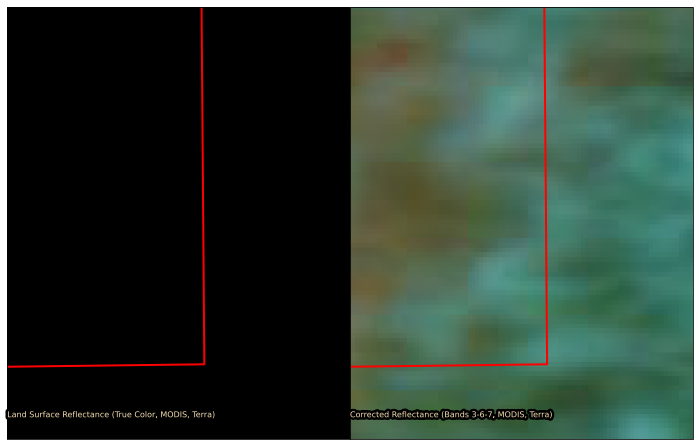

In [ ]:
def main():
    # URL of NASA GIBS
    URL = 'http://gibs.earthdata.nasa.gov/wmts/epsg4326/best/wmts.cgi'
    wmts = WebMapTileService(URL)

    # Layers for MODIS true color and snow RGB
    layers = ['MODIS_Terra_SurfaceReflectance_Bands143',
              'MODIS_Terra_CorrectedReflectance_Bands367']
    #layers = ['MODIS_Terra_CorrectedReflectance_Bands367']


    date_str = '2022-07-23'

    # Plot setup
    plot_CRS = ccrs.Mercator()
    geodetic_CRS = ccrs.Geodetic()
    x0, y0 = plot_CRS.transform_point(-119.6, 37.7, geodetic_CRS)
    x1, y1 = plot_CRS.transform_point(-119.4, 37.9, geodetic_CRS)
    ysize = 6
    xsize = 2 * ysize * (x1 - x0) / (y1 - y0)
    fig = plt.figure(figsize=(xsize, ysize))

    for layer, offset in zip(layers, [0, 0.5]):
        ax = plt.axes([offset, 0, 0.5, 1], projection=plot_CRS)
        ax.set_xlim((x0, x1))
        ax.set_ylim((y0, y1))

        ax.add_wmts(wmts, layer, wmts_kwargs={'time': date_str})
        ax.add_feature(shape_feature, zorder = 1)
        #ax.add_geometries([shapely.wkt.loads(amsterdamish.to_wkt())], ccrs.Geodetic(),                  facecolor='#D127FA', edgecolor='white', zorder=1)

        txt = plt.text(-119.6, 37.71, wmts[layer].title, fontsize=8,color='wheat', transform=geodetic_CRS)
        txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='black')])

    plt.show()

if __name__ == '__main__':
    main()

# Terra: 07-24 -Band-143(L):367(R)  local

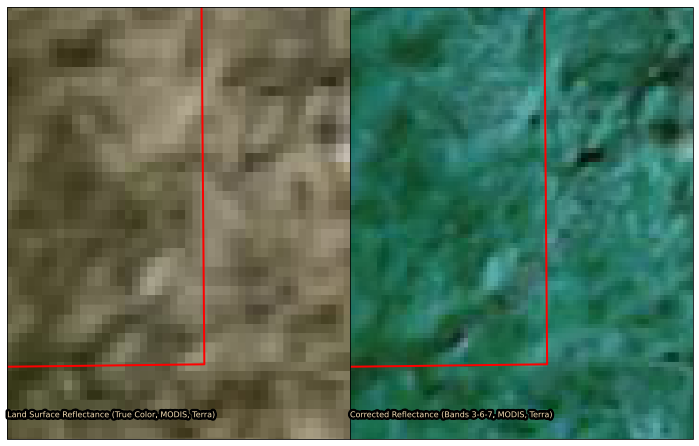

In [ ]:
def main():
    # URL of NASA GIBS
    URL = 'http://gibs.earthdata.nasa.gov/wmts/epsg4326/best/wmts.cgi'
    wmts = WebMapTileService(URL)

    # Layers for MODIS true color and snow RGB
    layers = ['MODIS_Terra_SurfaceReflectance_Bands143',
              'MODIS_Terra_CorrectedReflectance_Bands367']
    #layers = ['MODIS_Terra_CorrectedReflectance_Bands367']


    date_str = '2022-07-24'

    # Plot setup
    plot_CRS = ccrs.Mercator()
    geodetic_CRS = ccrs.Geodetic()
    x0, y0 = plot_CRS.transform_point(-119.6, 37.7, geodetic_CRS)
    x1, y1 = plot_CRS.transform_point(-119.4, 37.9, geodetic_CRS)
    ysize = 6
    xsize = 2 * ysize * (x1 - x0) / (y1 - y0)
    fig = plt.figure(figsize=(xsize, ysize))

    for layer, offset in zip(layers, [0, 0.5]):
        ax = plt.axes([offset, 0, 0.5, 1], projection=plot_CRS)
        ax.set_xlim((x0, x1))
        ax.set_ylim((y0, y1))

        ax.add_wmts(wmts, layer, wmts_kwargs={'time': date_str})
        ax.add_feature(shape_feature, zorder = 1)
        #ax.add_geometries([shapely.wkt.loads(amsterdamish.to_wkt())], ccrs.Geodetic(),                  facecolor='#D127FA', edgecolor='white', zorder=1)

        txt = plt.text(-119.6, 37.71, wmts[layer].title, fontsize=8,color='wheat', transform=geodetic_CRS)
        txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='black')])

    plt.show()

if __name__ == '__main__':
    main()

# Terra: 07-25 -Band-143(L):367(R)  local

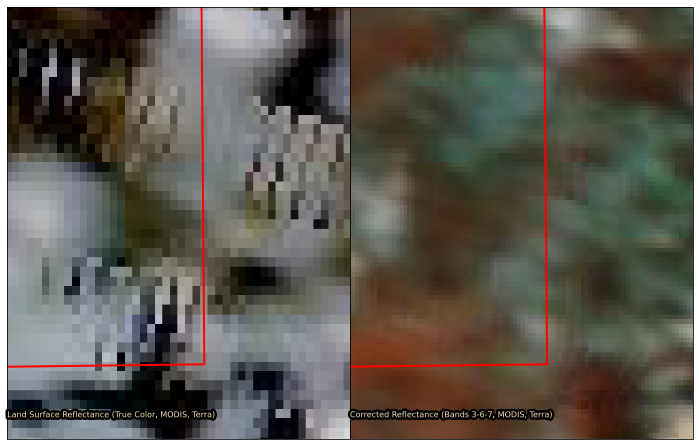

In [ ]:
def main():
    # URL of NASA GIBS
    URL = 'http://gibs.earthdata.nasa.gov/wmts/epsg4326/best/wmts.cgi'
    wmts = WebMapTileService(URL)

    # Layers for MODIS true color and snow RGB
    layers = ['MODIS_Terra_SurfaceReflectance_Bands143',
              'MODIS_Terra_CorrectedReflectance_Bands367']
    #layers = ['MODIS_Terra_CorrectedReflectance_Bands367']


    date_str = '2022-07-25'

    # Plot setup
    plot_CRS = ccrs.Mercator()
    geodetic_CRS = ccrs.Geodetic()
    x0, y0 = plot_CRS.transform_point(-119.6, 37.7, geodetic_CRS)
    x1, y1 = plot_CRS.transform_point(-119.4, 37.9, geodetic_CRS)
    ysize = 6
    xsize = 2 * ysize * (x1 - x0) / (y1 - y0)
    fig = plt.figure(figsize=(xsize, ysize))

    for layer, offset in zip(layers, [0, 0.5]):
        ax = plt.axes([offset, 0, 0.5, 1], projection=plot_CRS)
        ax.set_xlim((x0, x1))
        ax.set_ylim((y0, y1))

        ax.add_wmts(wmts, layer, wmts_kwargs={'time': date_str})
        ax.add_feature(shape_feature, zorder = 1)
        #ax.add_geometries([shapely.wkt.loads(amsterdamish.to_wkt())], ccrs.Geodetic(),                  facecolor='#D127FA', edgecolor='white', zorder=1)

        txt = plt.text(-119.6, 37.71, wmts[layer].title, fontsize=8,color='wheat', transform=geodetic_CRS)
        txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground='black')])

    plt.show()

if __name__ == '__main__':
    main()

In [ ]:
import folium
from folium.raster_layers import WmsTileLayer
from folium.raster_layers import TileLayer
from folium import plugins

# Interactive map 25,July, Click Map-Control

In [ ]:
start_coords = (37.8,-119.6 )
folium_map = folium.Map(
    location=start_coords,
    zoom_start=9,
    width='80%',
    crs='EPSG3857',
)
src = (
    'http://map1.vis.earthdata.nasa.gov/wmts-webmerc/{layer}/'
    + 'default/{time}/GoogleMapsCompatible_Level9/{z}/{y}/{x}.jpg'
)


TileLayer(
    tiles=src,
    subdomains='abc',
    name='VIIRS_True Color',
    attr='NASA VIIRS',
    overlay=True,
    layer='VIIRS_SNPP_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
).add_to(folium_map)


TileLayer(
    tiles=src,
    subdomains='abc',
    name='VIIRS Bands M11-I2-I1',
    attr='NASA VIIRS',
    overlay=True,
    show=False,
    layer='VIIRS_SNPP_CorrectedReflectance_BandsM11-I2-I1',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
).add_to(folium_map)



TileLayer(
    tiles=src,
    subdomains='abc',
    name='VIIRS Bands M3-I3-M11',
    attr='NASA VIIRS',
    overlay=True,
    show=False,
    layer='VIIRS_SNPP_CorrectedReflectance_BandsM3-I3-M11',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
).add_to(folium_map)

TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Terra',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Terra_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
).add_to(folium_map)

TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Aqua',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Aqua_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
).add_to(folium_map)
'''
for _, r in cal.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry'])
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['SHORTNAME']).add_to(geo_j)
    geo_j.add_to(folium_map)
'''
folium.GeoJson(cal,name='Region').add_to(folium_map)
folium.CircleMarker(location=(37.86510,-119.53833 ),radius=10, fill_color='red',color='yellow').add_to(folium_map)
folium.LayerControl().add_to(folium_map)
minimap = plugins.MiniMap()
folium_map.add_child(minimap)

folium_map

# VIIRS Interactive map from  22, July to 25, Click Map-Control

In [ ]:
start_coords = (37.8,-119.6 )
folium_map = folium.Map(
    location=start_coords,
    zoom_start=9,
    width='80%',
    crs='EPSG3857',
)
src = (
    'http://map1.vis.earthdata.nasa.gov/wmts-webmerc/{layer}/'
    + 'default/{time}/GoogleMapsCompatible_Level9/{z}/{y}/{x}.jpg'
)

w0=TileLayer(
    tiles=src,
    subdomains='abc',
    name='VIIRS_True Color 0722',
    attr='NASA VIIRS',
    overlay=True,
    layer='VIIRS_SNPP_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-22',
    tileSize=256,
)
w0.add_to(folium_map)
w1=TileLayer(
    tiles=src,
    subdomains='abc',
    name='VIIRS_True Color 0723',
    attr='NASA VIIRS',
    overlay=True,
    layer='VIIRS_SNPP_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-23',
    tileSize=256,
)

w1.add_to(folium_map)
w2=TileLayer(
    tiles=src,
    subdomains='abc',
    name='VIIRS_True Color 0724',
    attr='NASA VIIRS',
    overlay=True,
    layer='VIIRS_SNPP_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-24',
    tileSize=256,
)
w2.add_to(folium_map)
w3=TileLayer(
    tiles=src,
    subdomains='abc',
    name='VIIRS_True Color 0725',
    attr='NASA VIIRS',
    overlay=True,
    layer='VIIRS_SNPP_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
)

w3.add_to(folium_map)

time = folium.plugins.TimestampedWmsTileLayers([w0, w1,w2,w3])
#time.add_to(folium_map)
'''
for _, r in cal.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry'])
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['SHORTNAME']).add_to(geo_j)
    geo_j.add_to(folium_map)
'''

folium.GeoJson(cal,name='Region').add_to(folium_map)
folium.CircleMarker(location=(37.8,-119.6),radius=13, fill_color='red',color='yellow').add_to(folium_map)
folium.LayerControl().add_to(folium_map)
minimap = plugins.MiniMap()
folium_map.add_child(minimap)

folium_map


# MODIS Interactive map from  22, July to 25, Click Map-Control

In [ ]:
start_coords = (37.8,-119.6 )
folium_map = folium.Map(
    location=start_coords,
    zoom_start=9,
    width='80%',
    crs='EPSG3857',
)
src = (
    'http://map1.vis.earthdata.nasa.gov/wmts-webmerc/{layer}/'
    + 'default/{time}/GoogleMapsCompatible_Level9/{z}/{y}/{x}.jpg'
)

TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Aqua_07_25',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Aqua_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
).add_to(folium_map)
TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Terra_07_25',
    attr='NASA GIBS',
    overlay=True,
    show=True,
    layer='MODIS_Terra_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-25',
    tileSize=256,
).add_to(folium_map)
TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Aqua_07_24',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Aqua_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-24',
    tileSize=256,
).add_to(folium_map)
TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Terra_07_24',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Terra_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-24',
    tileSize=256,
).add_to(folium_map)
TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Aqua_07_23',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Aqua_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-23',
    tileSize=256,
).add_to(folium_map)
TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Terra_07_23',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Terra_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-23',
    tileSize=256,
).add_to(folium_map)
TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Aqua_07_22',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Aqua_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-22',
    tileSize=256,
).add_to(folium_map)
TileLayer(
    tiles='https://gibs-{s}.earthdata.nasa.gov/wmts/epsg3857/best/'
    + '{layer}/default/{time}/{tileMatrixSet}/{z}/{y}/{x}.jpg',
    subdomains='abc',
    name='MODIS_Terra_07_22',
    attr='NASA GIBS',
    overlay=True,
    show=False,
    layer='MODIS_Terra_CorrectedReflectance_TrueColor',
    tileMatrixSet='GoogleMapsCompatible_Level9',
    time='2022-07-22',
    tileSize=256,
).add_to(folium_map)
'''
for _, r in cal.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry'])
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['SHORTNAME']).add_to(geo_j)
    geo_j.add_to(folium_map)
'''

folium.GeoJson(cal,name='Region').add_to(folium_map)
folium.CircleMarker(location=(37.8,-119.6),radius=13, fill_color='red',color='yellow').add_to(folium_map)
folium.LayerControl().add_to(folium_map)
minimap = plugins.MiniMap()
folium_map.add_child(minimap)

folium_map


In [ ]:
!jupyter nbconvert --to html  plot_fire_Cal.ipynb --no-input

[NbConvertApp] WARNING | Config option `kernel_spec_manager_class` not recognized by `NbConvertApp`.
[NbConvertApp] Converting notebook plot_fire_Cal.ipynb to html
[NbConvertApp] Writing 34102555 bytes to plot_fire_Cal.html
